In [68]:
import pandas as pd
import seaborn as sns
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
from unidecode import unidecode

In [69]:
import plotly.io as pio
# pio.renderers.default = "vscode"
pio.renderers.default = "notebook_connected"

# Database

![alt text](../data/database.png "Base de Dados")

# ETL

In [70]:
df_customers = pd.read_csv('../data/olist_customers_dataset.csv')

df_geolocation = pd.read_csv('../data/olist_geolocation_dataset.csv')
df_geolocation['geolocation_city']=df_geolocation['geolocation_city'].apply(lambda x: unidecode(x).lower())
df_geolocation['geolocation_state']=df_geolocation['geolocation_state'].apply(lambda x: unidecode(x).upper())

df_order_items: pd.DataFrame = pd.read_csv('../data/olist_order_items_dataset.csv')
date_columns = ['shipping_limit_date']
for column in date_columns:
    df_order_items[column] = pd.to_datetime(df_order_items[column])
df_order_items['year'] = df_order_items['shipping_limit_date'].dt.year

df_order_payments = pd.read_csv('../data/olist_order_payments_dataset.csv')

df_order_reviews = pd.read_csv('../data/olist_order_reviews_dataset.csv')

df_orders = pd.read_csv('../data/olist_orders_dataset.csv')
date_columns = ['order_purchase_timestamp', 'order_delivered_carrier_date', 'order_delivered_customer_date', 'order_estimated_delivery_date']
for column in date_columns:
    df_orders[column] = pd.to_datetime(df_orders[column])
    
df_orders['year'] = df_orders['order_purchase_timestamp'].dt.year

df_products = pd.read_csv('../data/olist_products_dataset.csv')

df_products['product_category_name']= df_products['product_category_name'].fillna('outros')

df_products.loc[:,'product_macro_category'] = df_products['product_category_name'].apply(lambda x: x.split('_')[0])

df_sellers = pd.read_csv('../data/olist_sellers_dataset.csv')

df_product_category_translation = pd.read_csv('../data/product_category_name_translation.csv')

# EDA

## Base de Dados

### df_orders

In [71]:
df_orders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,year
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,2017
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,2018
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,2018
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15,2017
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26,2018


In [72]:
df_orders.describe()

,order_purchase_timestamp,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,year
count,99441,97658,96476,99441,99441.000000
mean,2017-12-31 08:43:12.776581120,2018-01-04 21:49:48.138278656,2018-01-14 12:09:19.035542272,2018-01-24 03:08:37.730111232,2017.539838
min,2016-09-04 21:15:19,2016-10-08 10:34:01,2016-10-11 13:46:32,2016-09-30 00:00:00,2016.000000
25%,2017-09-12 14:46:19,2017-09-15 22:28:50.249999872,2017-09-25 22:07:22.249999872,2017-10-03 00:00:00,2017.000000
50%,2018-01-18 23:04:36,2018-01-24 16:10:58,2018-02-02 19:28:10.500000,2018-02-15 00:00:00,2018.000000
75%,2018-05-04 15:42:16,2018-05-08 13:37:45,2018-05-15 22:48:52.249999872,2018-05-25 00:00:00,2018.000000
max,2018-10-17 17:30:18,2018-09-11 19:48:28,2018-10-17 13:22:46,2018-11-12 00:00:00,2018.000000
std,NaN,NaN,NaN,NaN,0.505007


### df_order_items

In [73]:
df_order_items.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,year
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29,2017
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93,2017
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87,2018
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79,2018
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14,2017


### df_order_payments

In [74]:
df_order_payments.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


### df_customers

In [75]:
df_customers.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


### df_geolocation

In [76]:
df_geolocation.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


### df_products

In [77]:
df_products.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_macro_category
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0,perfumaria
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0,artes
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0,esporte
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0,bebes
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0,utilidades


In [78]:
len(df_products['product_category_name'].unique())

74

In [79]:
sorted(df_products['product_category_name'].unique())

['agro_industria_e_comercio',
 'alimentos',
 'alimentos_bebidas',
 'artes',
 'artes_e_artesanato',
 'artigos_de_festas',
 'artigos_de_natal',
 'audio',
 'automotivo',
 'bebes',
 'bebidas',
 'beleza_saude',
 'brinquedos',
 'cama_mesa_banho',
 'casa_conforto',
 'casa_conforto_2',
 'casa_construcao',
 'cds_dvds_musicais',
 'cine_foto',
 'climatizacao',
 'consoles_games',
 'construcao_ferramentas_construcao',
 'construcao_ferramentas_ferramentas',
 'construcao_ferramentas_iluminacao',
 'construcao_ferramentas_jardim',
 'construcao_ferramentas_seguranca',
 'cool_stuff',
 'dvds_blu_ray',
 'eletrodomesticos',
 'eletrodomesticos_2',
 'eletronicos',
 'eletroportateis',
 'esporte_lazer',
 'fashion_bolsas_e_acessorios',
 'fashion_calcados',
 'fashion_esporte',
 'fashion_roupa_feminina',
 'fashion_roupa_infanto_juvenil',
 'fashion_roupa_masculina',
 'fashion_underwear_e_moda_praia',
 'ferramentas_jardim',
 'flores',
 'fraldas_higiene',
 'industria_comercio_e_negocios',
 'informatica_acessorios',
 

In [80]:
len(df_products['product_macro_category'].unique())

49

In [81]:
sorted(df_products['product_macro_category'].unique())

['agro',
 'alimentos',
 'artes',
 'artigos',
 'audio',
 'automotivo',
 'bebes',
 'bebidas',
 'beleza',
 'brinquedos',
 'cama',
 'casa',
 'cds',
 'cine',
 'climatizacao',
 'consoles',
 'construcao',
 'cool',
 'dvds',
 'eletrodomesticos',
 'eletronicos',
 'eletroportateis',
 'esporte',
 'fashion',
 'ferramentas',
 'flores',
 'fraldas',
 'industria',
 'informatica',
 'instrumentos',
 'la',
 'livros',
 'malas',
 'market',
 'moveis',
 'musica',
 'outros',
 'papelaria',
 'pc',
 'pcs',
 'perfumaria',
 'pet',
 'portateis',
 'relogios',
 'seguros',
 'sinalizacao',
 'tablets',
 'telefonia',
 'utilidades']

## Padrão consumo da Olist

### Total de pedidos em cada ano

In [82]:
df_orders.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'year'],
      dtype='object')

In [83]:
df_orders.groupby('year')['order_id'].count()

year
2016      329
2017    45101
2018    54011
Name: order_id, dtype: int64

In [84]:
df_order_items.groupby('year')['order_id'].count()

year
2016      370
2017    49765
2018    62511
2020        4
Name: order_id, dtype: int64

Decisão: Usar apenas os pedidos de 2017 e 2018

## Consumo por Categoria

In [85]:
order_items_columns = ['product_id', 'price', 'freight_value', 'year']
df_order_items[order_items_columns].head()

,product_id,price,freight_value,year
0,4244733e06e7ecb4970a6e2683c13e61,58.90,13.29,2017
1,e5f2d52b802189ee658865ca93d83a8f,239.90,19.93,2017
2,c777355d18b72b67abbeef9df44fd0fd,199.00,17.87,2018
3,7634da152a4610f1595efa32f14722fc,12.99,12.79,2018
4,ac6c3623068f30de03045865e4e10089,199.90,18.14,2017


In [86]:
products_columns = ['product_id', 'product_category_name', 'product_macro_category']
df_products[products_columns].sample(11)

,product_id,product_category_name,product_macro_category
17412,10ea4a7c88d50bd3568146a5522d8d42,telefonia,telefonia
18319,dcf52f4379548f058d90279fe9fc3f14,esporte_lazer,esporte
12795,b0db5c7b3cdf07d5d6de413ad86bc1d1,automotivo,automotivo
17715,52a8061c8e8e8cea30b41344aac26431,beleza_saude,beleza
28060,87f32391c5f0737ea530496f114ce38b,livros_interesse_geral,livros
26099,74a5674a56a91708881d311a6b23e74d,perfumaria,perfumaria
31297,83ddda548094ac28ff6290b22b843f99,utilidades_domesticas,utilidades
8408,80db55ab8514dce76cb6a22d5014b73a,esporte_lazer,esporte
32921,2b6535d32c6996c9478c131a8ff17a05,construcao_ferramentas_seguranca,construcao
11249,30b159b653b87754d7a38446c7ef4669,fashion_bolsas_e_acessorios,fashion


In [87]:
df_category: pd.DataFrame = df_order_items[order_items_columns].merge(df_products[products_columns], on='product_id')

mask_2017_2018 = df_category['year'].between(2017,2018)
df_category = df_category[mask_2017_2018]
df_category.head()

,product_id,price,freight_value,year,product_category_name,product_macro_category
0,4244733e06e7ecb4970a6e2683c13e61,58.90,13.29,2017,cool_stuff,cool
1,e5f2d52b802189ee658865ca93d83a8f,239.90,19.93,2017,pet_shop,pet
2,c777355d18b72b67abbeef9df44fd0fd,199.00,17.87,2018,moveis_decoracao,moveis
3,7634da152a4610f1595efa32f14722fc,12.99,12.79,2018,perfumaria,perfumaria
4,ac6c3623068f30de03045865e4e10089,199.90,18.14,2017,ferramentas_jardim,ferramentas


In [88]:
agg_dict = {'price':'sum'}
group_by_columns = ['product_category_name','year']
df_category_per_year = df_category.groupby(group_by_columns).agg(agg_dict).reset_index()
df_category_per_year

,product_category_name,year,price
0,agro_industria_e_comercio,2017,28525.40
1,agro_industria_e_comercio,2018,44005.07
2,alimentos,2017,8475.49
3,alimentos,2018,20838.02
4,alimentos_bebidas,2017,7346.94
...,...,...,...
141,telefonia,2018,182403.08
142,telefonia_fixa,2017,30262.94
143,telefonia_fixa,2018,28615.18
144,utilidades_domesticas,2017,225744.41


In [89]:
agg_dict = {'price':'sum'}
group_by_columns = ['product_macro_category','year']
df_macro_category_per_year = df_category.groupby(group_by_columns).agg(agg_dict).reset_index()
df_macro_category_per_year

,product_macro_category,year,price
0,agro,2017,28525.40
1,agro,2018,44005.07
2,alimentos,2017,15822.43
3,alimentos,2018,28670.56
4,artes,2017,9403.68
...,...,...,...
92,tablets,2018,1267.96
93,telefonia,2017,170967.81
94,telefonia,2018,211018.26
95,utilidades,2017,225744.41


In [90]:
agg_dict = {'price':'sum'}
group_by_columns = ['product_macro_category']
df_macro_category = df_category.groupby(group_by_columns).agg(agg_dict).reset_index()
df_macro_category.sample(1)

,product_macro_category,price
15,consoles,153582.96


In [91]:
agg_dict = {'price':'sum'}
group_by_columns = ['product_macro_category','year']
df_macro_category_per_year = df_category.groupby(group_by_columns).agg(agg_dict).reset_index()
df_macro_category_per_year.sample(1)

,product_macro_category,year,price
75,papelaria,2018,141150.05


In [92]:
df = df_category_per_year
max_y = df['price'].max()

fig = px.bar(
    df, x="product_category_name", y="price",
    animation_frame="year",
    range_y=[0,max_y*1.05]
    )
fig.show()

In [187]:
df = df_macro_category_per_year
max_y = df['price'].max()

fig = px.bar(
    df.sort_values(by='price', ascending=False), x="product_macro_category", y="price",
    animation_frame="year",
    range_y=[0,max_y*1.05]
    )
fig.show()

## Tendencia

In [94]:
df_macro_category_per_year.head()

,product_macro_category,year,price
0,agro,2017,28525.40
1,agro,2018,44005.07
2,alimentos,2017,15822.43
3,alimentos,2018,28670.56
4,artes,2017,9403.68


In [95]:
df_pivot_macro_category_per_year = pd.pivot_table(
    data=df_macro_category_per_year,
    index='product_macro_category',
    columns = 'year',
    values='price'
    ).reset_index()
df_pivot_macro_category_per_year.head()

year,product_macro_category,2017,2018
0,agro,28525.40,44005.07
1,alimentos,15822.43,28670.56
2,artes,9403.68,16612.97
3,artigos,4597.39,8688.61
4,audio,16295.70,34235.81


In [96]:
df_pivot_macro_category_per_year['tendency'] = df_pivot_macro_category_per_year[2018] - df_pivot_macro_category_per_year[2017]
df_pivot_macro_category_per_year.head()

year,product_macro_category,2017,2018,tendency
0,agro,28525.40,44005.07,15479.67
1,alimentos,15822.43,28670.56,12848.13
2,artes,9403.68,16612.97,7209.29
3,artigos,4597.39,8688.61,4091.22
4,audio,16295.70,34235.81,17940.11


## Categorias que mais cresceram entre 2017 e 2018

<Axes: xlabel='tendency', ylabel='product_macro_category'>

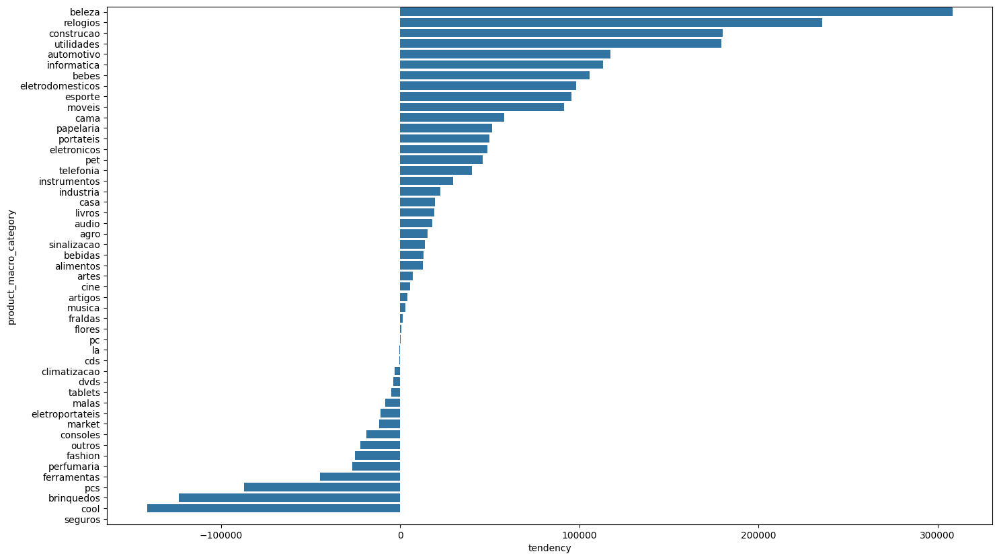

In [97]:
fig, ax = plt.subplots(1,1, figsize=(17,10))
sns.barplot(
    data=df_pivot_macro_category_per_year.sort_values('tendency', ascending=False),
    y='product_macro_category',
    x='tendency',
    orient = 'h',
    ax=ax
    )

## Categorias que mais venderam por ano

- 2018

<Axes: xlabel='2017', ylabel='product_macro_category'>

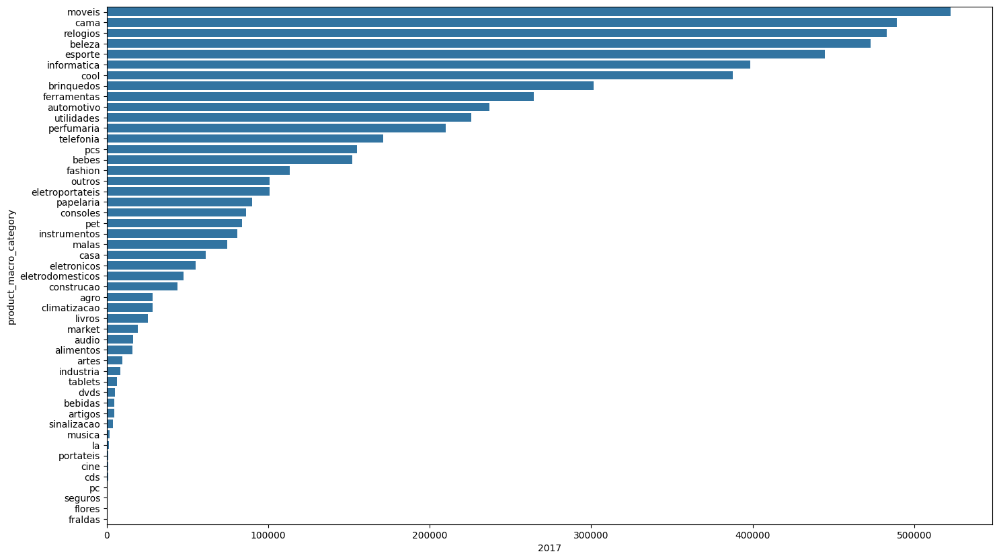

In [98]:
year = 2017

fig, ax = plt.subplots(1,1, figsize=(17,10))
sns.barplot(
    data=df_pivot_macro_category_per_year.sort_values(year, ascending=False),
    y='product_macro_category',
    x=year,
    orient = 'h',
    ax=ax
    )

- 2017

<Axes: xlabel='2018', ylabel='product_macro_category'>

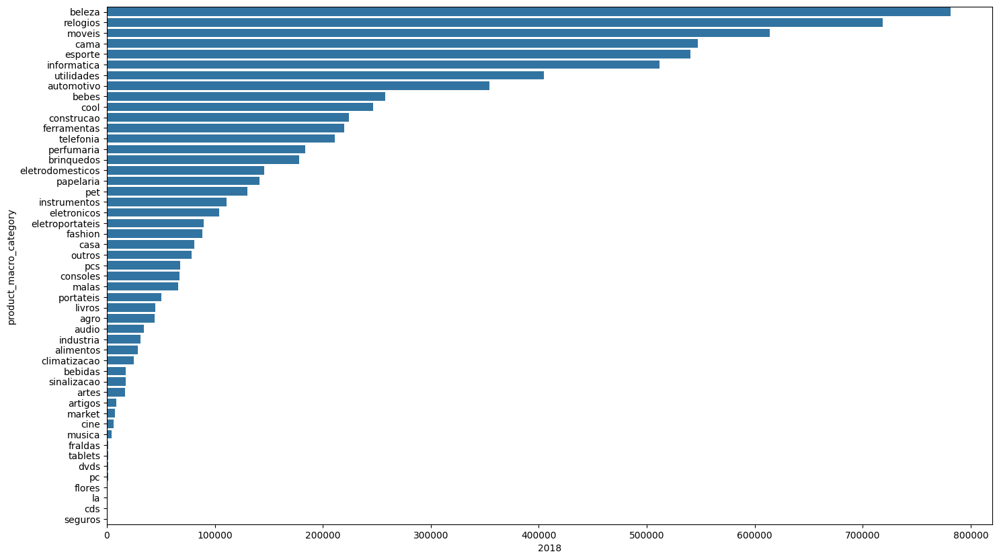

In [99]:
year = 2018

fig, ax = plt.subplots(1,1, figsize=(17,10))
sns.barplot(
    data=df_pivot_macro_category_per_year.sort_values(year, ascending=False),
    y='product_macro_category',
    x=year,
    orient = 'h',
    ax=ax
    )

## Crescimento das categorias que mais venderam em 2018

<Axes: xlabel='tendency', ylabel='product_macro_category'>

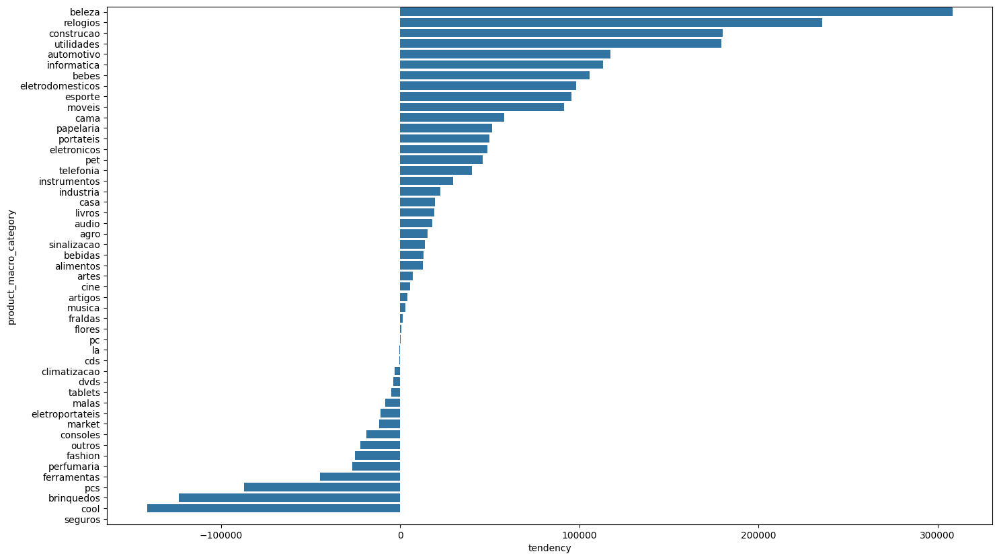

In [100]:
fig, ax = plt.subplots(1,1, figsize=(17,10))
sns.barplot(
    data=df_pivot_macro_category_per_year.sort_values('tendency', ascending=False),
    y='product_macro_category',
    x='tendency',
    orient = 'h',
    ax=ax
    )

## Local das compras

### Base suja: cidades e estados

In [101]:
df_geolocation.sort_values('geolocation_zip_code_prefix').head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
1246,1001,-23.549292,-46.633559,sao paulo,SP
429,1001,-23.550498,-46.634338,sao paulo,SP
1182,1001,-23.549779,-46.633957,sao paulo,SP
1435,1001,-23.549292,-46.633559,sao paulo,SP
326,1001,-23.551427,-46.634074,sao paulo,SP


In [102]:
df_geolocation.columns

Index(['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng',
       'geolocation_city', 'geolocation_state'],
      dtype='object')

In [103]:
geolocation_group_by_columns = ['geolocation_zip_code_prefix', 'geolocation_city', 'geolocation_state']
agg_dict = {
    'geolocation_lat':'mean',
    'geolocation_lng':'mean'
}
df_unique_geolocation = df_geolocation.groupby(geolocation_group_by_columns).agg(agg_dict).reset_index()
df_unique_geolocation

,geolocation_zip_code_prefix,geolocation_city,geolocation_state,geolocation_lat,geolocation_lng
0,1001,sao paulo,SP,-23.550190,-46.634024
1,1002,sao paulo,SP,-23.548146,-46.634979
2,1003,sao paulo,SP,-23.548994,-46.635731
3,1004,sao paulo,SP,-23.549799,-46.634757
4,1005,sao paulo,SP,-23.549456,-46.636733
...,...,...,...,...,...
19613,99960,charrua,RS,-27.953722,-52.025511
19614,99965,agua santa,RS,-28.183372,-52.039850
19615,99970,ciriaco,RS,-28.343766,-51.874689
19616,99980,david canabarro,RS,-28.389129,-51.843836


In [104]:
mask = df_unique_geolocation['geolocation_zip_code_prefix'].duplicated(keep=False)

In [105]:
df_unique_geolocation[mask].head(30)

,geolocation_zip_code_prefix,geolocation_city,geolocation_state,geolocation_lat,geolocation_lng
159,1307,sao bernardo do campo,SP,-23.556812,-46.657135
160,1307,sao paulo,SP,-23.552765,-46.653195
368,2116,sao paulo,RN,-23.515978,-46.582170
369,2116,sao paulo,SP,-23.520455,-46.585496
1096,3203,jundiai,SP,-23.216648,-46.861371
1097,3203,sao paulo,SP,-23.601261,-46.567832
1664,4004,sao paulo,SP,-23.573747,-46.646244
1665,4004,taboao da serra,SP,-23.574798,-46.650106
1672,4011,sao paulo,AC,-23.578707,-46.645779
1673,4011,sao paulo,SP,-23.579522,-46.644071


Decisão: Não usar o nome da cidade e do estado por enquanto

In [106]:
geolocation_group_by_columns = ['geolocation_zip_code_prefix']
agg_dict = {
    'geolocation_lat':'mean',
    'geolocation_lng':'mean'
}
df_unique_geolocation = df_geolocation.groupby(geolocation_group_by_columns).agg(agg_dict).reset_index()
df_unique_geolocation

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng
0,1001,-23.550190,-46.634024
1,1002,-23.548146,-46.634979
2,1003,-23.548994,-46.635731
3,1004,-23.549799,-46.634757
4,1005,-23.549456,-46.636733
...,...,...,...
19010,99960,-27.953722,-52.025511
19011,99965,-28.183372,-52.039850
19012,99970,-28.343766,-51.874689
19013,99980,-28.389129,-51.843836


In [107]:
orders_columns = ['order_id', 'customer_id', 'year']
df_orders[orders_columns].head()

,order_id,customer_id,year
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,2017
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,2018
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,2018
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,2017
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,2018


In [108]:
agg_dict = {
    'price': 'sum',
    'freight_value': 'sum'
}
df_order_prices = df_order_items.groupby('order_id').agg(agg_dict).reset_index()
df_order_prices.head()

,order_id,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,199.90,18.14


In [125]:
customers_columns = ['customer_id', 'customer_zip_code_prefix']
df_customers[customers_columns].head()

,customer_id,customer_zip_code_prefix
0,06b8999e2fba1a1fbc88172c00ba8bc7,14409
1,18955e83d337fd6b2def6b18a428ac77,9790
2,4e7b3e00288586ebd08712fdd0374a03,1151
3,b2b6027bc5c5109e529d4dc6358b12c3,8775
4,4f2d8ab171c80ec8364f7c12e35b23ad,13056


In [110]:
geolocation_columns = ['geolocation_zip_code_prefix','geolocation_lat', 'geolocation_lng']
df_unique_geolocation[geolocation_columns].head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng
0,1001,-23.550190,-46.634024
1,1002,-23.548146,-46.634979
2,1003,-23.548994,-46.635731
3,1004,-23.549799,-46.634757
4,1005,-23.549456,-46.636733


In [130]:
mask_2017_2018 = df_orders['year'].between(2017,2018)
orders_columns = ['order_id', 'customer_id', 'year']

df_geolocation_orders = df_orders.loc[mask_2017_2018, orders_columns].merge(
    df_customers[customers_columns], 
    on='customer_id', 
    how='left'
    ).merge(
            df_unique_geolocation[geolocation_columns], 
            left_on='customer_zip_code_prefix', 
            right_on='geolocation_zip_code_prefix', 
            how='left'
        ).merge(
                df_order_prices, 
                on='order_id', 
                how='left'
            )


df_geolocation_orders.head(10)

,order_id,customer_id,year,customer_zip_code_prefix,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,price,freight_value
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,2017,3149,3149.0,-23.576983,-46.587161,29.99,8.72
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,2018,47813,47813.0,-12.177924,-44.660711,118.70,22.76
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,2018,75265,75265.0,-16.745150,-48.514783,159.90,19.22
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,2017,59296,59296.0,-5.774190,-35.271143,45.00,27.20
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,2018,9195,9195.0,-23.676370,-46.514627,19.90,8.72
5,a4591c265e18cb1dcee52889e2d8acc3,503740e9ca751ccdda7ba28e9ab8f608,2017,86320,86320.0,-23.553522,-50.549924,147.90,27.36
6,136cce7faa42fdb2cefd53fdc79a6098,ed0271e0b7da060a393796590e7b737a,2017,98900,98900.0,-27.865358,-54.470128,49.90,16.05
7,6514b8ad8028c9f2cc2374ded245783f,9bdf08b4b3b52b5526ff42d37d47f222,2017,26525,26525.0,-22.805707,-43.423079,59.99,15.17
8,76c6e866289321a7c93b82b54852dc33,f54a9f0e6b351c431402b8461ea51999,2017,99655,99655.0,-27.421769,-52.675022,19.90,16.05
9,e69bfb5eb88e0ed6a785585b27e16dbf,31ad1d1b63eb9962463f764d4e6e0c9d,2017,18075,18075.0,-23.474030,-47.467397,149.99,19.77


In [112]:
for column in df_geolocation_orders.columns:
    print(column,df_geolocation_orders.columns.isna().sum())

order_id 0
customer_id 0
year 0
customer_zip_code_prefix 0
geolocation_zip_code_prefix 0
geolocation_lat 0
geolocation_lng 0
price 0
freight_value 0


### Gastos por macro categoria

In [113]:
order_items_columns = ['order_id', 'product_id', 'price', 'freight_value',]
df_order_items[order_items_columns].head()

,order_id,product_id,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,4244733e06e7ecb4970a6e2683c13e61,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,e5f2d52b802189ee658865ca93d83a8f,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,c777355d18b72b67abbeef9df44fd0fd,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,7634da152a4610f1595efa32f14722fc,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,ac6c3623068f30de03045865e4e10089,199.90,18.14


In [114]:
products_columns = ['product_id', 'product_macro_category']
df_products[products_columns].head()

,product_id,product_macro_category
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria
1,3aa071139cb16b67ca9e5dea641aaa2f,artes
2,96bd76ec8810374ed1b65e291975717f,esporte
3,cef67bcfe19066a932b7673e239eb23d,bebes
4,9dc1a7de274444849c219cff195d0b71,utilidades


In [115]:
orders_columns = ['order_id', 'customer_id', 'year']
df_orders[orders_columns].head()

,order_id,customer_id,year
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,2017
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,2018
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,2018
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,2017
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,2018


In [116]:
customers_columns = ['customer_id', 'customer_zip_code_prefix']
df_customers[customers_columns].head()

,customer_id,customer_zip_code_prefix
0,06b8999e2fba1a1fbc88172c00ba8bc7,14409
1,18955e83d337fd6b2def6b18a428ac77,9790
2,4e7b3e00288586ebd08712fdd0374a03,1151
3,b2b6027bc5c5109e529d4dc6358b12c3,8775
4,4f2d8ab171c80ec8364f7c12e35b23ad,13056


In [117]:
df_unique_geolocation.columns

Index(['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng'], dtype='object')

In [134]:
mask_2017_2018 = df_orders['year'].between(2017,2018)
order_items_columns = ['order_id', 'product_id', 'price', 'freight_value',]

df_geolocation_categories: pd.DataFrame = df_order_items[order_items_columns].merge(
        df_products[products_columns], 
        on='product_id', 
        how='left'
    ).merge(
            df_orders[orders_columns], 
            on='order_id', 
            how='left'
        ).merge(
                df_customers[customers_columns], 
                on='customer_id', 
                how='left'
            ).merge(
                    df_unique_geolocation, 
                    left_on='customer_zip_code_prefix', 
                    right_on='geolocation_zip_code_prefix', 
                    how='left'
                )

mask_2017_2018 = df_geolocation_categories['year'].between(2017,2018)
df_geolocation_categories = df_geolocation_categories[mask_2017_2018]
df_geolocation_categories.head(10)

,order_id,product_id,price,freight_value,product_macro_category,customer_id,year,customer_zip_code_prefix,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng
0,00010242fe8c5a6d1ba2dd792cb16214,4244733e06e7ecb4970a6e2683c13e61,58.90,13.29,cool,3ce436f183e68e07877b285a838db11a,2017,28013,28013.0,-21.762775,-41.309633
1,00018f77f2f0320c557190d7a144bdd3,e5f2d52b802189ee658865ca93d83a8f,239.90,19.93,pet,f6dd3ec061db4e3987629fe6b26e5cce,2017,15775,15775.0,-20.220527,-50.903424
2,000229ec398224ef6ca0657da4fc703e,c777355d18b72b67abbeef9df44fd0fd,199.00,17.87,moveis,6489ae5e4333f3693df5ad4372dab6d3,2018,35661,35661.0,-19.870305,-44.593326
3,00024acbcdf0a6daa1e931b038114c75,7634da152a4610f1595efa32f14722fc,12.99,12.79,perfumaria,d4eb9395c8c0431ee92fce09860c5a06,2018,12952,12952.0,-23.089925,-46.611654
4,00042b26cf59d7ce69dfabb4e55b4fd9,ac6c3623068f30de03045865e4e10089,199.90,18.14,ferramentas,58dbd0b2d70206bf40e62cd34e84d795,2017,13226,13226.0,-23.243402,-46.827614
5,00048cc3ae777c65dbb7d2a0634bc1ea,ef92defde845ab8450f9d70c526ef70f,21.90,12.69,utilidades,816cbea969fe5b689b39cfc97a506742,2017,38017,38017.0,-19.740199,-47.924793
6,00054e8431b9d7675808bcb819fb4a32,8d4f2bb7e93e6710a28f34fa83ee7d28,19.90,11.85,telefonia,32e2e6ab09e778d99bf2e0ecd4898718,2017,16700,16700.0,-21.250587,-50.646445
7,000576fe39319847cbb9d288c5617fa6,557d850972a7d6f792fd18ae1400d9b6,810.00,70.75,ferramentas,9ed5e522dd9dd85b4af4a077526d8117,2018,11702,11702.0,-24.014395,-46.438358
8,0005a1a1728c9d785b8e2b08b904576c,310ae3c140ff94b03219ad0adc3c778f,145.95,11.65,beleza,16150771dfd4776261284213b89c304e,2018,11075,11075.0,-23.954600,-46.337731
9,0005f50442cb953dcd1d21e1fb923495,4535b0e1091c278dfd193e5a1d63b39f,53.99,11.40,livros,351d3cb2cee3c7fd0af6616c82df21d3,2018,6636,6636.0,-23.556620,-46.899041


In [119]:
df_geolocation_categories.shape

(112280, 11)

### Mais sobre o frete

In [170]:
df_geolocation_orders.head()

,order_id,customer_id,year,customer_zip_code_prefix,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,price,freight_value
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,2017,3149,3149.0,-23.576983,-46.587161,29.99,8.72
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,2018,47813,47813.0,-12.177924,-44.660711,118.70,22.76
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,2018,75265,75265.0,-16.745150,-48.514783,159.90,19.22
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,2017,59296,59296.0,-5.774190,-35.271143,45.00,27.20
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,2018,9195,9195.0,-23.676370,-46.514627,19.90,8.72


In [199]:
df_freight_value_columns = ['order_id', 'customer_id', 'year', 'customer_zip_code_prefix', 'freight_value', 'price']
df_freight_value_test: pd.DataFrame = df_geolocation_orders[df_freight_value_columns]

df_freight_value_test = df_freight_value_test.dropna(subset='freight_value')
df_freight_value_test = df_freight_value_test.sort_values('freight_value', ascending=False)
df_freight_value_test

,order_id,customer_id,year,customer_zip_code_prefix,freight_value,price
20009,cf4659487be50c0c317cff3564c4a840,ed583a2a1eaf0dedc33af816153e8b8c,2018,58407,1794.96,1050.00
63493,2455cbeb73fd04b170ca2504662f95ce,5e312b0d9bf5c91599eb42120e633b19,2017,84174,1002.29,419.40
88480,cfed507ac357129f750f05a0d7d71b15,088d20d5878711d537176871a6e850e4,2018,65800,711.33,1380.00
16284,71dab1155600756af6de79de92e712e3,8c20d9bfbc96c5d39025d77a3ba83d7f,2018,48410,626.64,1361.89
27874,17784b9fbb37fb0bdc230d8ed6f6b355,023cf83ac35d703a6f3c1b31bcf844d5,2018,44900,502.98,840.00
...,...,...,...,...,...,...
75885,ddc162708923f29398f06661ac27c18a,f2d29d306dd51bd69fd4a75f95bfb058,2018,81850,0.00,99.90
53949,7e680cdc973a1bda4710a1fc19e990a7,dd972f6d2508a778dce6aa6f6c9b325a,2018,48540,0.00,69.90
13269,410a396b1c7bbf059e3f2d028342177b,9a05001f24b3be9b63a671530944fdfb,2018,13780,0.00,69.90
20989,7de1ba35d9d0422c7129096639f316c9,82246fa860dbc4d1e81654bb922253de,2018,20771,0.00,69.90


In [195]:
regiao_nordeste = ['BA', 'CE', 'MA', 'PB', 'PE', 'PI', 'RN', 'SE', 'AL']
regiao_sudeste = ['SP', 'RJ', 'MG', 'ES']
regiao_norte = ['AM', 'PA', 'AP', 'RR', 'RO', 'AC', 'TO']
regiao_centro_oeste = ['MT', 'MS', 'GO', 'DF']
regiao_sul = ['PR', 'SC', 'RS']

In [196]:
def get_region(customer_state: str) -> str:
    if customer_state in regiao_nordeste:
        return 'Nordeste'
    elif customer_state in regiao_sudeste:
        return "Sudeste"
    elif customer_state in regiao_norte:
        return "Norte"
    elif customer_state in regiao_centro_oeste:
        return "Centro-Oeste"
    elif customer_state in regiao_sul:
        return "Sul"
    else:
        return "Brasil"
    

In [209]:
costumer_city_state_mask = ['customer_id','customer_city', 'customer_state']

df_customers_region = df_freight_value_test.merge(df_customers[costumer_city_state_mask], how="left", on="customer_id")
df_customers_region.head()
# df_customers['customer_state'].unique()

,order_id,customer_id,year,customer_zip_code_prefix,freight_value,price,customer_city,customer_state
0,cf4659487be50c0c317cff3564c4a840,ed583a2a1eaf0dedc33af816153e8b8c,2018,58407,1794.96,1050.00,campina grande,PB
1,2455cbeb73fd04b170ca2504662f95ce,5e312b0d9bf5c91599eb42120e633b19,2017,84174,1002.29,419.40,castro,PR
2,cfed507ac357129f750f05a0d7d71b15,088d20d5878711d537176871a6e850e4,2018,65800,711.33,1380.00,balsas,MA
3,71dab1155600756af6de79de92e712e3,8c20d9bfbc96c5d39025d77a3ba83d7f,2018,48410,626.64,1361.89,cicero dantas,BA
4,17784b9fbb37fb0bdc230d8ed6f6b355,023cf83ac35d703a6f3c1b31bcf844d5,2018,44900,502.98,840.00,irece,BA


In [211]:
df_customers_region['region'] = df_customers_region['customer_state'].apply(get_region)
df_customers_region


,order_id,customer_id,year,customer_zip_code_prefix,freight_value,price,customer_city,customer_state,region
0,cf4659487be50c0c317cff3564c4a840,ed583a2a1eaf0dedc33af816153e8b8c,2018,58407,1794.96,1050.00,campina grande,PB,Nordeste
1,2455cbeb73fd04b170ca2504662f95ce,5e312b0d9bf5c91599eb42120e633b19,2017,84174,1002.29,419.40,castro,PR,Sul
2,cfed507ac357129f750f05a0d7d71b15,088d20d5878711d537176871a6e850e4,2018,65800,711.33,1380.00,balsas,MA,Nordeste
3,71dab1155600756af6de79de92e712e3,8c20d9bfbc96c5d39025d77a3ba83d7f,2018,48410,626.64,1361.89,cicero dantas,BA,Nordeste
4,17784b9fbb37fb0bdc230d8ed6f6b355,023cf83ac35d703a6f3c1b31bcf844d5,2018,44900,502.98,840.00,irece,BA,Nordeste
...,...,...,...,...,...,...,...,...,...
98349,ddc162708923f29398f06661ac27c18a,f2d29d306dd51bd69fd4a75f95bfb058,2018,81850,0.00,99.90,curitiba,PR,Sul
98350,7e680cdc973a1bda4710a1fc19e990a7,dd972f6d2508a778dce6aa6f6c9b325a,2018,48540,0.00,69.90,jeremoabo,BA,Nordeste
98351,410a396b1c7bbf059e3f2d028342177b,9a05001f24b3be9b63a671530944fdfb,2018,13780,0.00,69.90,divinolandia,SP,Sudeste
98352,7de1ba35d9d0422c7129096639f316c9,82246fa860dbc4d1e81654bb922253de,2018,20771,0.00,69.90,rio de janeiro,RJ,Sudeste


In [219]:
columns_customers_region = ['customer_id', 'customer_state', 'region'] 
df_customers_region_geolocation_categories: pd.DataFrame = df_order_items[order_items_columns].merge(
        df_products[products_columns], 
        on='product_id', 
        how='left'
    ).merge(
            df_orders[orders_columns], 
            on='order_id', 
            how='left'
        ).merge(
                df_customers[customers_columns], 
                on='customer_id', 
                how='left'
            ).merge(
                    df_unique_geolocation, 
                    left_on='customer_zip_code_prefix', 
                    right_on='geolocation_zip_code_prefix', 
                    how='left'
                ).merge(df_customers_region[columns_customers_region], on='customer_id', how='left')

df_customers_region_geolocation_categories

,order_id,product_id,price,freight_value,product_macro_category,customer_id,year,customer_zip_code_prefix,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,customer_state,region
0,00010242fe8c5a6d1ba2dd792cb16214,4244733e06e7ecb4970a6e2683c13e61,58.90,13.29,cool,3ce436f183e68e07877b285a838db11a,2017,28013,28013.0,-21.762775,-41.309633,RJ,Sudeste
1,00018f77f2f0320c557190d7a144bdd3,e5f2d52b802189ee658865ca93d83a8f,239.90,19.93,pet,f6dd3ec061db4e3987629fe6b26e5cce,2017,15775,15775.0,-20.220527,-50.903424,SP,Sudeste
2,000229ec398224ef6ca0657da4fc703e,c777355d18b72b67abbeef9df44fd0fd,199.00,17.87,moveis,6489ae5e4333f3693df5ad4372dab6d3,2018,35661,35661.0,-19.870305,-44.593326,MG,Sudeste
3,00024acbcdf0a6daa1e931b038114c75,7634da152a4610f1595efa32f14722fc,12.99,12.79,perfumaria,d4eb9395c8c0431ee92fce09860c5a06,2018,12952,12952.0,-23.089925,-46.611654,SP,Sudeste
4,00042b26cf59d7ce69dfabb4e55b4fd9,ac6c3623068f30de03045865e4e10089,199.90,18.14,ferramentas,58dbd0b2d70206bf40e62cd34e84d795,2017,13226,13226.0,-23.243402,-46.827614,SP,Sudeste
...,...,...,...,...,...,...,...,...,...,...,...,...,...
112645,fffc94f6ce00a00581880bf54a75a037,4aa6014eceb682077f9dc4bffebc05b0,299.99,43.41,utilidades,b51593916b4b8e0d6f66f2ae24f2673d,2018,65077,65077.0,-2.497993,-44.297761,MA,Nordeste
112646,fffcd46ef2263f404302a634eb57f7eb,32e07fd915822b0765e448c4dd74c828,350.00,36.53,informatica,84c5d4fbaf120aae381fad077416eaa0,2018,81690,81690.0,-25.566904,-49.309115,PR,Sul
112647,fffce4705a9662cd70adb13d4a31832d,72a30483855e2eafc67aee5dc2560482,99.90,16.95,esporte,29309aa813182aaddc9b259e31b870e6,2017,4039,4039.0,-23.597794,-46.643923,SP,Sudeste
112648,fffe18544ffabc95dfada21779c9644f,9c422a519119dcad7575db5af1ba540e,55.99,8.72,informatica,b5e6afd5a41800fdf401e0272ca74655,2017,13289,13289.0,-23.040252,-46.979782,SP,Sudeste


### Scatter Map dos Pedidos

In [167]:
df_geolocation_orders.head()

,order_id,customer_id,year,customer_zip_code_prefix,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,price,freight_value
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,2017,3149,3149.0,-23.576983,-46.587161,29.99,8.72
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,2018,47813,47813.0,-12.177924,-44.660711,118.70,22.76
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,2018,75265,75265.0,-16.745150,-48.514783,159.90,19.22
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,2017,59296,59296.0,-5.774190,-35.271143,45.00,27.20
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,2018,9195,9195.0,-23.676370,-46.514627,19.90,8.72


In [166]:
year_mask = df_geolocation_orders['year'] == 2017

# df = df_geolocation_orders[year_mask].dropna()
df = df_geolocation_orders.dropna()

fig = px.scatter_map(
        df, 
        lat="geolocation_lat", 
        lon="geolocation_lng", 
        size="price", 
        size_max=15, 
        zoom=2.8, 
        animation_frame="year",
    )

fig.show()

- Mapa por preço do frete

In [168]:
year_mask = df_geolocation_orders['year'] == 2017

# df = df_geolocation_orders[year_mask].dropna()
df = df_geolocation_orders.dropna()

fig = px.scatter_map(
        df, 
        lat="geolocation_lat", 
        lon="geolocation_lng", 
        size="freight_value", 
        size_max=15, 
        zoom=2.8, 
        animation_frame="year",
    )

fig.show()

### Mapa de Calor dos Pedidos

In [202]:
df = df_geolocation_orders

import plotly.express as px
fig = px.density_map(df, lat='geolocation_lat', lon='geolocation_lng', z='price', radius=10,
                        center=dict(lat=0, lon=180), zoom=0,
                        map_style="open-street-map")
fig.show()

In [186]:
df = df_geolocation_categories

fig = px.scatter_map(df, lat="geolocation_lat", lon="geolocation_lng", size="price", size_max=15, zoom=10, color="product_macro_category",
    animation_frame="year",)
fig.show()

# Clusterização de Clientes

1 - Clusterizar os clientes por **padrão de consumo**
- Definir features para clusterização:
    - Identificar features existentes
    - Criar features à partir das existentes

- Calcular número ótimo dos clusters

- Eleger 2 ou 3 tipos diferentes de modelos de clusterização

- Através do PCA identificar se os clusters estão separados (vizualizações 2D e 3D)

2 - Análise dos Clusters
- Identificar as principais características dos usuários de cada cluster
    - Padrão de consumo
    - Dados de localização

3 - Conclusão
- Como o estudo acima pode impactar no negócio
    - Cluster que mais gera lucro
    - Onde está localizado
    - Quais produtos ele consome
    - Sugestão de localização de um CD ou Loja e dos produtos 
    


## Definição das features de padrão de consumo

- Compras em 1 ano
- Ticket médio
- Itens por cesta
- Gasto por macro categoria

Entender como as categorias se relacionam